In [1]:
#General libraries
import pandas as pd
import tabula as tb
import numpy as np
from collections import OrderedDict
from itertools import islice
#visualization
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import seaborn as sns
#math related libraries
import statistics
import scipy.stats
#Setting the max display
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
#Feature scaling libraries
import umap.umap_ as umap #installed using --> pip install umap-learn #import uamp did not work 
#modeling libraries
from sklearn.cluster import KMeans

# Question 1  **Time_taken = 5 hours**

Visualize the following data and identify any areas that require further investigation, with explanation as to why.

In [2]:
#From the given pdf file the question1 table is extracted and converted to the following csv file "Question1.csv"
class question_1:
    
    filename =""
    df = pd.DataFrame()
    dataframes_list = []
    
    def __init__(self, f):
        self.filename = f
    
    #Extracting data from the pdf file
    def extract_data(self):
        tb.convert_into(self.filename, "Question1.csv", output_format="csv", pages='all')
        print("Table is extracted from the pdf file")
    
    #Reading the csv file
    def read_csv(self):
        self.df = pd.read_csv("Question1.csv", names = ['DateTime','Player1ID', 'Player2ID','Player1Score','Player2Score'])
        print(self.df)
        print("Dataframe is successfully created")
    
    #The below method split the dataset into different combinations according to player1Id and player2Id
    def split_games(self):
        #Getting unique players ID from 'Player1ID' and 'Player2ID' columns
        player1_uinque= self.df['Player1ID'].unique()
        player2_uinque= self.df['Player2ID'].unique()

        player_list = []
        empty = pd.DataFrame()
        multiple_players = pd.DataFrame()
        #df['DateTime']= pd.to_datetime(self.df['DateTime']) #converting DateTime column into DateTime type

        #Checking all possible available combinations between player1 and player 2 in the dataset
        for player1 in player1_uinque:
            for player2 in player2_uinque:
                temp = self.df[(self.df['Player1ID'] == player1) & (self.df['Player2ID'] == player2)]
                if  temp.empty:
                    pass
                else:
                    if len(self.df[(self.df['Player1ID'] == player1)]) == 1 and len(self.df[(self.df['Player2ID'] == player2)]) > 1:
                        multiple_players = pd.concat([multiple_players,temp], ignore_index=True)
                    else:
                        #The player_list is a list type and appends all the dataframes of differnt combinations together
                        player_list.append(temp)

        player_list.append(multiple_players) #Appending the multiple players dataframe to the list of dataframes
        print("There are {} combinations of player id's playing against each other in the dataset".format(len(player_list)))
        #print(player_list)
        self.dataframes_list = player_list
    
    #The below function is used to display which player_id is playing against each other    
    def display_player_combinations(self): 
        for dataframe in self.dataframes_list:
            print(str(dataframe['Player1ID'].unique())+" vs "+str(dataframe['Player2ID'].unique())+"\n")
            
    #The line_chart is displayed for the player1 vs player 2 for all combinations
    def line_chart(self):
        for df in self.dataframes_list:
            fig = go.Figure()
            fig.add_trace(go.Scatter(x=df['DateTime'], y=df['Player1Score'], name="Player1"))
            fig.add_trace(go.Scatter(x=df['DateTime'], y=df['Player2Score'], name="Player2"))
            fig.update_layout(title= str(df['Player1ID'].unique())+" vs "+str(df['Player2ID'].unique())+" scoreline during the game", xaxis_title="DateTime", yaxis_title="Scores")
            fig.show("notebook")
    
    #The bar_chart is displayed for the player1 vs player 2 for all combinations
    def bar_chart(self):
        for df in self.dataframes_list:
            trace1 = go.Bar(x = df["DateTime"], y=df["Player1Score"], name = "Player1", hoverinfo=None)
            trace2 = go.Bar(x = df["DateTime"], y=df["Player2Score"], name = "Player2", hoverinfo=None) 
            data = [trace1,trace2]
            layout = go.Layout(barmode='group',
                               legend=dict(x=0.7, y=1.2,orientation="h"),
                               yaxis=dict(title='scores'),
                               yaxis2=dict(title = 'DateTime',
                                           overlaying = 'y',
                                           side='right'),
                               font=dict(family="Courier New, monospace",
                                          size=11,
                                          color="RebeccaPurple"),
                              title = str(df['Player1ID'].unique())+" vs "+str(df['Player2ID'].unique()))
            fig = go.Figure(data=data, layout=layout)
            fig.show("notebook")
        # filename - "Epic_Games_Data_Intern.pdf"

In [3]:
x = question_1("Epic_Games_Data_Intern.pdf")
x.extract_data()
x.read_csv()
x.split_games()
x.display_player_combinations()


Table is extracted from the pdf file
           DateTime  Player1ID  Player2ID  Player1Score  Player2Score
0    5/27/2015 1:00       1121       1451           200           250
1    5/27/2015 1:01       1121       1451           250           260
2    5/27/2015 1:02       1121       1451           300           270
3    5/27/2015 1:03       1121       1451           400           200
4    5/27/2015 1:04       1121       1451          1000           260
5    5/27/2015 1:05       1121       1451           300           300
6    5/27/2015 1:06       1121       1451           200           205
7    5/27/2015 1:07       1121       1451           100           400
8    5/27/2015 1:09       1121       1451           100           300
9    5/27/2015 1:10       1121       1451           200           200
10   5/27/2015 1:11       1121       1451           200           250
11  5/27/2015 12:00       6013       4215            50           300
12  5/27/2015 12:01       6103       4215           3

In [5]:
x.line_chart()

In [6]:
x.bar_chart()

## Result 1


- The main investigation needs to be done on the 4th minute of the gameplay for all the 3 combinations of the games. As you can see there is spike at 4th minute during all the gameplay that the spike happens especially for the player_1 not against player_2. The possible reason for the spike might be due to a bug or glitch on the code, which helps the player_1 to win everytime during the 4th minute of the gameplay.
- The second important investigtaion on the follwoing matches between the [1121] and [1451] player_id's. There was no gameplay score recorded at the eigth minute of the match. To be exact, after 05/27/2015 1:07 there was no 1:08 time displayed. This is might be possible due to the internet lag on both the end of the players and the game might be tried to reconnect for one minute to resume the game from where it started. That's why the score and the time must have been not recorded
- The third investigation needs to be analyzed is there were two combinations of matches was happening constantly between the two players [1121] vs [1451] and [2013] and [1121], when i saw this, i thought the match was played as the survival game and whoever stands at the last might be the winner but there was one combiantion of players who was playing against multiple players [6013 6103 6193 6283 6373 6463 6553 6643 6733 6823 6913] vs [4215]. This combination made me to think about the online multipleyer games with friends and the rest of the players. The first two combinations might be two friends who might be playing 11 times against each other or a game is played for 11 minutes. If a game is played for 11 minutes then how multiple players can play against the same player. This needs to be further investigated.
- Still there were lot of area can be visualized and analyzed but due to the time constraint, I was not able to perform all the analysis. One of the possible analysis is we can create an achievement table like wins, losses, win_per, lose_perc, draw, number of games played, total points won, highest point and lowest point will defenitely help to analyze the minute details about wheather the player is chaeting or how is he performing on all the macthes, how's th win reocrd. Why the other players are not performing and much more.

# Question 2  Time Taken = 15 hours

#### Parant class - *question2* helps to hold the dataframe for both of it's child classes question_2b and question_2c for accessing. It gets the filepath from the child class when the object is created and stores as the super class attribute. The parent class also helps to print the dataframe from the child calsses or through it's objects.

In [7]:
class question2:
    dataframe = pd.DataFrame()
    
    def __init__(self, filepath):
        self.dataframe = pd.read_csv(filepath)
        print("Dataframe created")
    
    def print_dataframe(self):
        print(self.dataframe)

# Question 2.b

Provide a statistical description of respondent education (educ) and household income (income) of the dataset at large, as well as in terms of number of teenagers in the household (p2)
a. Income bins: (1) < 10k, (2) 10k - 20k, (3) 20k-30k, (4) 30k-40k, (5) 40k-50k, (6) 50k-75k, (7) 75k-100k, (8) 100k+, (9) Don’t know / refused
b. Education bins: (1) none/grades 1-8, (2) some high school, (3) high school graduate (4) vocational education post-high school (5) some college (6) college degree (7) some post graduate education or more, (9) Don’t know / refused


In [8]:
class question2_b(question2):
    
    standard_crosstab = pd.DataFrame()
    p2_cross_tab = pd.DataFrame()
    p2_crosstab_list = []
    
    def __init__(self, filepath):
        super().__init__(filepath)
        columns = ['p2','educ', 'income']
        dataframe = self.dataframe[columns]
        print("Filtered the dataframe")
    
    def preprocess(self):
        
        print("Checking if any null values are present in the dataframe")
        if self.dataframe.isnull().values.any():
            print("Nan values are present")
        else:
            print("No Nan values are present")
            
        #Creating two empty columns
        self.dataframe["category_educ"] = np.nan 
        self.dataframe["category_income"] = np.nan
        
        #The integers are mapped to their respective categorical variabels listed on the question for easy analysis.
        dict_map = {1:'none_one_to_eight',2:'high_school',3:'graduate',
                    4:'vocational_education', 5:'some_college', 6:'college_degree', 7:'post_graduate_more', 9:'refused' }
        self.dataframe['category_educ'] = self.dataframe['educ'].map(dict_map)
        
        dict_map = {1:'less_10',2:'10_to_20',3:'20_to_30',
                    4:'30_to_40', 5:'40_to_50', 6:'50_to_75', 7:'75_to_100', 8:'100_plus', 9:'refused' }
        self.dataframe['category_income'] = self.dataframe['income'].map(dict_map)
        print("\nTwo new columns category_educ and category_income are created")

        print("\nDropping income and educ column from the dataframe")
        self.dataframe.drop(['educ', 'income'], axis=1)
        
        print("\n A crosstab is created between category_educ and category_income columns")
        self.standard_crosstab = pd.crosstab(self.dataframe.category_educ, self.dataframe.category_income)
        
    def chi_square_test(self):
        print("\nCreating crosstab with row and column to calcualte row_total and col_total")
        margin_crosstab = pd.crosstab(self.dataframe.category_educ, self.dataframe.category_income, margins=True, margins_name="Total")
        print(margin_crosstab)
        
        margin_crosstab.columns = ['100_plus','10_to_20','20_to_30',
                    '30_to_40', '40_to_50', '50_to_75', '75_to_100', 'less_10', 'refused', 'row_total' ]
        margin_crosstab.index = ['college_degree', 'graduate', 'high_school', 'mid_school', 'post_graduate_more', 'refused', 'some_college','vocational_education','col_total']

        observed = margin_crosstab.iloc[0:8,0:9]   # Get table without totals for later use
        #print(observed)

        #Calculating the expected value for Chi-Square Test by multiplying col_total with row_toal and dividing by the total 
        expected =  np.outer(margin_crosstab["row_total"][0:8],margin_crosstab.loc["col_total"][0:9]) / margin_crosstab['row_total'][8]
        #print(expected)

        chi_squared_stat = (((observed-expected)**2)/expected).sum().sum()
        print("\nchi_squared_stat for income vs educ: ",chi_squared_stat)

        critical_value= scipy.stats.chi2.ppf(q = 0.95, df = 56)
        print("\ncritical_value for income and educ: ",critical_value)

        p_value = 1.0 - scipy.stats.chi2.cdf(x=chi_squared_stat,  df=56)
        print("\nP_value for income and educ: ",p_value)
 
        #print(scipy.stats.chi2_contingency(observed= observed))
    
    #Printing a bar chart for all the categories in the income vs education as a percentage to understand the distribution
    def visualize_distribution(self):
        print("\nVisualization for income against education")
        perc_crosstab = pd.crosstab(self.dataframe.category_educ,self.dataframe.category_income, normalize='columns')
        perc_dataframe = pd.DataFrame(perc_crosstab)
        fig = go.Figure()

        fig.update_layout(
            template="simple_white",
            xaxis=dict(title_text="Income"),
            yaxis=dict(title_text="Percentage"),
            barmode="stack",
        )
        colors = ["orange", "red", "black", "pink", "green", "yellow", "purple", "blue"]
        for r, c in zip(perc_dataframe.index, colors):
            plot_df = perc_dataframe.loc[perc_dataframe.index == r]
            fig.add_trace(
                go.Bar(x=plot_df.columns, y=[plot_df.iloc[:,i][0] for i in range(perc_dataframe.shape[1] - 1)], name=r, marker_color=c),
            )
        fig.show("notebook")
    
    def create_p2_crosstab(self):
        self.p2_cross_tab = pd.crosstab(self.dataframe.category_educ, [self.dataframe.category_income, self.dataframe.p2], margins=True, margins_name="Total")
        print(self.p2_cross_tab)
        
    # Slicing the p2 columns (1,2,3,4) into four dataframes with respect to category_income and category_educ
    def preprocess_p2(self):
        one_teenager = self.p2_cross_tab.xs(1, level=1, axis=1)
        two_teenager = self.p2_cross_tab.xs(2, level=1, axis=1)
        three_teenager = self.p2_cross_tab.xs(3, level=1, axis=1)
        four_teenager = self.p2_cross_tab.xs(4, level=1, axis=1)
        print("\nCrosstab is sliced into four crosstab according to the number of teenagers living in the house")
        self.p2_crosstab_list = [one_teenager, two_teenager, three_teenager, four_teenager]
        
        print("\nRow total is calculated for all the four crosstabs")
        new_list = []
        for teenager in self.p2_crosstab_list:
            teenager['row_total'] = [teenager.loc[row].sum() for row in teenager.index ]
            new_list.append(teenager)
        self.p2_crosstab_list = new_list
        
    def calculate_chi_square_teenagers(self):
        string_list = ["one_teenager", "two_teenager", "three_teenager", "four_teenager"]
        for index, teenager in enumerate(self.p2_crosstab_list):
            print("\n"+string_list[index]+":")
            row = len(teenager.index) - 1 
            col = len(teenager.columns) - 1
            observed = teenager.iloc[0:row,0:col]   # Get table without totals for later use
            #Calculating the expected value for Chi-Square Test by multiplying col_total with row_toal and dividing by the total 
            expected =  np.outer(teenager["row_total"][0:row],
                             teenager.loc["Total"][0:col]) / teenager.loc['Total'][col]
            chi_squared_stat = (((observed-expected)**2)/expected).sum().sum()
            print("\nChi_squared_stat for "+ string_list[index] +"is: ",chi_squared_stat)
            critical_value= scipy.stats.chi2.ppf(q = 0.95, df = 56)
            print("Critical_value "+ string_list[index] +"is: ", critical_value)
            p_value = 1.0 - scipy.stats.chi2.cdf(x=chi_squared_stat,  df=56)
            print("P_value "+ string_list[index] +"is: ", p_value)
            #print(scipy.stats.chi2_contingency(observed = observed))
            
    def visualize_distribution_teenagers(self):
        cross_tab = pd.crosstab(self.dataframe.category_educ, [self.dataframe.category_income, self.dataframe.p2], normalize='columns')
        string_list = ["one_teenager", "two_teenager", "three_teenager", "four_teenager"]
        for index, teenager in enumerate(self.p2_crosstab_list):
            print("\nVisualization for income, education and "+string_list[index]+" living in the house")
            perc_dataframe = pd.DataFrame(teenager)

            fig = go.Figure()

            fig.update_layout(
                template="simple_white",
                xaxis=dict(title_text="Income"),
                yaxis=dict(title_text="Percentage"),
                barmode="stack",
            )

            colors = ["orange", "red", "black", "pink", "green", "yellow", "purple", "blue"]

            for r, c in zip(perc_dataframe.index, colors):
                plot_df = perc_dataframe.loc[perc_dataframe.index == r]
                fig.add_trace(
                    go.Bar(x=plot_df.columns, y=[plot_df.iloc[:,i][0] for i in range(perc_dataframe.shape[1] - 1)], name=r, marker_color=c),
                )

            fig.show("notebook")

In [9]:
#The statistical description test for income against education
test_obj = question2_b("Question_2/Teens_Gaming_2008_csv.csv")
test_obj.preprocess()
test_obj.chi_square_test()
test_obj.visualize_distribution()
#The statistical description test for income, education and number of teenagers
test_obj.create_p2_crosstab()
test_obj.preprocess_p2()
test_obj.calculate_chi_square_teenagers()
test_obj.visualize_distribution_teenagers()


Dataframe created
Filtered the dataframe
Checking if any null values are present in the dataframe
No Nan values are present

Two new columns category_educ and category_income are created

Dropping income and educ column from the dataframe

 A crosstab is created between category_educ and category_income columns

Creating crosstab with row and column to calcualte row_total and col_total
category_income       100_plus  10_to_20  20_to_30  30_to_40  40_to_50  \
category_educ                                                            
college_degree              85         5        10        13        22   
graduate                    17        21        37        39        28   
high_school                  2         7         7         8         3   
none_one_to_eight            0         5         4         5         1   
post_graduate_more          68         2         2         4         6   
refused                      0         1         0         0         1   
some_college       

category_income      100_plus           10_to_20          20_to_30            \
p2                          1   2  3  4        1  2  3  4        1   2  3  4   
category_educ                                                                  
college_degree             55  26  3  1        3  2  0  0        5   3  1  1   
graduate                   11   5  0  1       16  4  0  1       29   7  0  1   
high_school                 1   1  0  0        6  0  1  0        4   3  0  0   
none_one_to_eight           0   0  0  0        3  1  0  1        2   2  0  0   
post_graduate_more         40  24  2  2        1  0  1  0        2   0  0  0   
refused                     0   0  0  0        0  1  0  0        0   0  0  0   
some_college               33  19  1  1        9  0  1  1       11   4  0  3   
vocational_education        3   2  0  0        4  0  0  0        3   3  0  0   
Total                     143  77  6  5       42  8  3  3       56  22  1  5   

category_income      30_to_40          

/var/folders/fv/gy1ltgf57t3f7krxgxy0xcz40000gn/T/ipykernel_30144/465464203.py:105: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/fv/gy1ltgf57t3f7krxgxy0xcz40000gn/T/ipykernel_30144/465464203.py:105: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/fv/gy1ltgf57t3f7krxgxy0xcz40000gn/T/ipykernel_30144/465464203.py:105: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th


Visualization for income, education and two_teenager living in the house



Visualization for income, education and three_teenager living in the house



Visualization for income, education and four_teenager living in the house


## Result
**Statistical Description for income against education**
- The first chi sqaure test against two catgorical columns (income against educ) resulted in p-value of **0.0** which is **less than 0.5**. Therefore, we will **reject** the null hypothesis. This means there is a very strong association between income and education.

**Statistical Description for income, education and number of teenagers living in the houae**
- Finally, we get a p-value of **1.792918028038094e-21** for **one_teenager** living in the house which is **less than 0.5**. Therefore, we will **reject** the null hypothesis. This means there is a very strong relationship between one teenger living in the house and income and education.

- For **two_teenagers** living in the house, we get a p-value of **9.732215033864122e-13** which is **less than 0.5**. Therefore, we will **reject** the null hypothesis. This means there is a very strong relationship between two teengers living in the house and income and education.

- For **three_teenagers** living in the house, we get a p-value of **0.8769126252716395** which is **greater than 0.5**. Therefore, we will **accept** the null hypothesis. This means there is no relationship between three teengers living in the house and income and education.

- For **four_teenagers** living in the house, we get a p-value of **0.7899502448307785** for four_teenager living in the house which is **greater than 0.5**. Therefore, we will **accept** the null hypothesis. This means there is no relationship between four teengers living in the house and income and education.

## Question 2.c

Columns k14{a..l} describe teenagers participation in various genres of games:

- a: fighting games, b: puzzle games, c: action games, d: FPS games, e: strategy games, f: simulation games, g: sports games, h: RPG games, i: adventure games, j: racing games, k: rhythm games & l: survival horror games (1 for YES, 2 for NO)

Using these columns, please create a clustering or labelling scheme for these respondents
* What are the clusters you found? Why did you select this partitioning?
* How would you describe these clusters?
* How do these groupings line up with what is reported as the respondents top 3 games from ©?

In [15]:
class question2_c(question2):
    
    one_hot_encoded_df = pd.DataFrame()
    umap_embedding = np.empty([1064,2])
    clusters = []
    tagged_clusters = []
    
    def __init__(self, filepath):
        super().__init__(filepath)
        self.dataframe = self.dataframe.filter(regex='k14[a-l]$')
        print("Filtered the dataframe")
    
    def get_datframe(self):
        return self.dataframe
    
    def data_exploratory(self, shape=False, describe=False, info=False, null=False):
        if shape: 
            print("\nPrinting the shape of the Dataframe")
            print(self.dataframe.shape)
        if describe: 
            print("\nDescribing the Dataframe")
            print(self.dataframe.describe())
        if info: 
            print("\nInfo of the Dataframe")
            print(self.dataframe.info())
        if null:
            print("\nDisplaying the counts of null values in the Dataframe")
            print(self.dataframe.isnull().sum())
        print("\nDisplaying the unique values in the Dataframe")
        for column in self.dataframe.columns:
            print(str(column), self.dataframe[column].unique())
                  
    def preprocessing(self):
        self.dataframe = self.dataframe.replace(' ', np.nan)
        print("Replaced the empty values with NAN")
        self.dataframe.rename(columns = {'k14a':'fighting_games', 'k14b':'puzzle_games', 'k14c':'action_games', 
                     'k14d':'FPS_games', 'k14e':'strategy_games', 'k14f':'simulation_games', 
                     'k14g':'sports_games', 'k14h':'RPG_games', 'k14i':'adventure_games',
                     'k14j':'racing_games', 'k14k':'rhythm_games', 'k14l':'survival_horror_games'}, inplace = True)
        print("Renamed the dataframe columns ")
                  
        print("\nFiltering the NAN rows")
        nan_values = self.dataframe[self.dataframe.isna().any(axis=1)]
        print("There are {} rows with NAN values".format(nan_values.shape))
        
        print("\nDisplaying the NAN percentage in each column")          
        for i in self.dataframe.columns:
        # count number of rows with missing values
            n_miss = self.dataframe[i].isnull().sum()
            perc = n_miss / self.dataframe.shape[0] * 100
            print('> %s, Missing: %d (%.1f%%)' % (i, n_miss, perc))
           
        self.dataframe=self.dataframe.dropna(thresh=2) #Dropping the rows if there are minimum nan values of 2
        print("\nNAN rows are dropped ", self.dataframe.shape)
        
        #According to the documentation there are only 3 unique values, object '8' is converted to '9'-don't know/refused
        print("Unknown object '8' is replaced by '9' ")
        self.dataframe = self.dataframe.replace('8', '9')
        
        #Renaming the object variables to understandable form
        for column in self.dataframe.columns:
            self.dataframe = self.dataframe.replace({column:{"1":"yes", "2":"no", "9":"refused"}})
        print("Renamed the object variables from 1 : yes, 2: no and 9 : refused ")
               
    def feature_extraction(self,display=False):
        self.one_hot_encoded_df = pd.concat([pd.get_dummies(self.dataframe[col], prefix=col) for col in self.dataframe.columns], axis=1)
        print("The new one hot encoded dataframe shape is ", self.one_hot_encoded_df.shape)
        if display:
            print(self.one_hot_encoded_df)
    
    def get_embedding(self, metric='euclidean', n_neighbors=10, n_components=2, random_state=42):
        print("Converting to embeddings")
        self.umap_embedding = (umap
                  .UMAP(metric= metric, n_neighbors=n_neighbors, n_components=n_components, random_state=random_state)
                  .fit_transform(self.one_hot_encoded_df))
        print("Embeddings converted successfully")
        return self.umap_embedding
        
    def model_Kmeans(self, embedding=None, n_clusters=50, init='k-means++', verbose=0, random_state=42, algorithm='auto'):
        print("Kmeans model is seperating the clusters")
        if embedding == None:
            embedding = self.umap_embedding
        self.clusters = (KMeans(n_clusters=n_clusters, init=init,
                  verbose=verbose, random_state=42,
                  algorithm=algorithm)
            .fit(embedding)
            .labels_)
        print("Kmeans clustered the data")
        self.dataframe.insert(0, "Cluster", self.clusters, True)
        return self.clusters
        
    def get_clusters(self):
        return np.unique(self.clusters)
    
    def visualize_clusters(self, embedding=None):
        if embedding == None:
            embedding = self.umap_embedding
        fig_2d = px.scatter(embedding, x=0, y=1)
        fig_2d.show("notebook")
    
    def label_cluster(self):
        
        for n in self.clusters:
            temp = self.dataframe.loc[self.dataframe['Cluster'] == n] #What cluster do you want to check
            labeled_cluster = {}
            for column in temp.columns[1:]:
                #print(temp[column].value_counts())
                string = ""
                category = temp[column].value_counts().keys().tolist()
                try:
                    index = category.index('yes')
                    #print(index)
                except ValueError:
                    pass
                if "yes" in category:
                    if temp[column].value_counts()[index] in labeled_cluster.keys():
                        string = labeled_cluster.get(temp[column].value_counts()[index])
                    labeled_cluster[temp[column].value_counts()[index]] = string+"_"+str(column[:column.index("_")])
                    
            self.tagged_clusters.append(" ".join([labeled_cluster[k] for k in sorted(labeled_cluster.keys(),reverse=True)[:3]]))
        
        self.dataframe.insert(0, "labeled_cluster", self.tagged_clusters, True)
        return self.dataframe
        

In [16]:
obj = question2_c("Question_2/Teens_Gaming_2008_csv.csv")
#obj.print_dataframe()
obj.data_exploratory(shape=True, describe=False, info=False, null=False) # Arguments default value: shape=False, describe=False, info=False, null=False
obj.preprocessing() #Preprocessing 
#obj.print_dataframe()
obj.feature_extraction() # One_hot_encoding is applied
obj.get_embedding(n_neighbors = 10) # Umap embedding is applied Arguments: metric='euclidean', n_neighbors=10, n_components=2
obj.model_Kmeans(n_clusters= 50) # Arguments: self, embedding=None, n_clusters=50, init='k-means++', verbose=0, random_state=42, algorithm='auto'
obj.visualize_clusters() # Visualizing the clustered data in 2d plotly grpah
obj.get_clusters() #Displaying a one dimenional cluster
#obj.display_cluster_counts()

Dataframe created
Filtered the dataframe

Printing the shape of the Dataframe
(1102, 12)

Displaying the unique values in the Dataframe
k14a ['1' '8' '2' ' ']
k14b ['1' '2' ' ']
k14c ['2' '1' ' ' '8']
k14d ['2' '1' ' ' '8']
k14e ['2' '1' ' ' '8']
k14f ['2' '1' ' ' '8' '9']
k14g ['1' '2' ' ']
k14h ['2' '1' ' ' '8']
k14i ['1' '2' ' ' '9' '8']
k14j ['1' '2' ' ']
k14k ['2' '1' ' ']
k14l ['2' '1' ' ' '9']
Replaced the empty values with NAN
Renamed the dataframe columns 

Filtering the NAN rows
There are (38, 12) rows with NAN values

Displaying the NAN percentage in each column
> fighting_games, Missing: 38 (3.4%)
> puzzle_games, Missing: 38 (3.4%)
> action_games, Missing: 38 (3.4%)
> FPS_games, Missing: 38 (3.4%)
> strategy_games, Missing: 38 (3.4%)
> simulation_games, Missing: 38 (3.4%)
> sports_games, Missing: 38 (3.4%)
> RPG_games, Missing: 38 (3.4%)
> adventure_games, Missing: 38 (3.4%)
> racing_games, Missing: 38 (3.4%)
> rhythm_games, Missing: 38 (3.4%)
> survival_horror_games, Missi

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49],
      dtype=int32)

In [17]:
df = obj.label_cluster()
df['labeled_cluster']


no     23
yes     5
Name: fighting_games, dtype: int64
yes    24
no      4
Name: puzzle_games, dtype: int64
no     27
yes     1
Name: action_games, dtype: int64
no     23
yes     5
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
no    28
Name: simulation_games, dtype: int64
yes    28
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
yes    24
no      4
Name: adventure_games, dtype: int64
yes    26
no      2
Name: racing_games, dtype: int64
no     24
yes     4
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
no         27
refused     1
Name: fighting_games, dtype: int64
yes    26
no      2
Name: puzzle_games, dtype: int64
no    28
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
yes    28
Name: simulation_games, dtype: int64
no     27
yes     1
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtyp

Name: racing_games, dtype: int64
no     24
yes     1
Name: rhythm_games, dtype: int64
no    25
Name: survival_horror_games, dtype: int64
yes    13
Name: fighting_games, dtype: int64
yes    12
no      1
Name: puzzle_games, dtype: int64
no     10
yes     3
Name: action_games, dtype: int64
yes    12
no      1
Name: FPS_games, dtype: int64
no     10
yes     3
Name: strategy_games, dtype: int64
no     7
yes    6
Name: simulation_games, dtype: int64
yes    13
Name: sports_games, dtype: int64
no     9
yes    4
Name: RPG_games, dtype: int64
yes    13
Name: adventure_games, dtype: int64
yes    13
Name: racing_games, dtype: int64
yes    13
Name: rhythm_games, dtype: int64
no    13
Name: survival_horror_games, dtype: int64
yes    20
no      1
Name: fighting_games, dtype: int64
yes    16
no      5
Name: puzzle_games, dtype: int64
yes    18
no      3
Name: action_games, dtype: int64
yes    11
no     10
Name: FPS_games, dtype: int64
yes    13
no      8
Name: strategy_games, dtype: int64
no    21
Nam

Name: FPS_games, dtype: int64
yes    19
no      7
Name: strategy_games, dtype: int64
no    26
Name: simulation_games, dtype: int64
yes    26
Name: sports_games, dtype: int64
yes    25
no      1
Name: RPG_games, dtype: int64
yes    22
no      4
Name: adventure_games, dtype: int64
yes    23
no      3
Name: racing_games, dtype: int64
yes    26
Name: rhythm_games, dtype: int64
yes    26
Name: survival_horror_games, dtype: int64
no     23
yes     5
Name: fighting_games, dtype: int64
yes    24
no      4
Name: puzzle_games, dtype: int64
no     27
yes     1
Name: action_games, dtype: int64
no     23
yes     5
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
no    28
Name: simulation_games, dtype: int64
yes    28
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
yes    24
no      4
Name: adventure_games, dtype: int64
yes    26
no      2
Name: racing_games, dtype: int64
no     24
yes     4
Name: rhythm_games, dtype: int64
no     27
yes   

Name: simulation_games, dtype: int64
yes    28
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
yes    24
no      4
Name: adventure_games, dtype: int64
yes    26
no      2
Name: racing_games, dtype: int64
no     24
yes     4
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
no     25
yes     3
Name: fighting_games, dtype: int64
yes    22
no      6
Name: puzzle_games, dtype: int64
yes    27
no      1
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
yes    27
no      1
Name: simulation_games, dtype: int64
yes    15
no     13
Name: sports_games, dtype: int64
no     27
yes     1
Name: RPG_games, dtype: int64
no    28
Name: adventure_games, dtype: int64
yes    25
no      3
Name: racing_games, dtype: int64
yes    25
no      3
Name: rhythm_games, dtype: int64
no     25
yes     3
Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fig

Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
no         29
refused     1
Name: action_games, dtype: int64
no     27
yes     3
Name: FPS_games, dtype: int64
no     16
yes    14
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    29
no      1
Name: sports_games, dtype: int64
no     21
yes     9
Name: RPG_games, dtype: int64
no     24
yes     6
Name: adventure_games, dtype: int64
yes    29
no      1
Name: racing_games, dtype: int64
yes    25
no      5
Name: rhythm_games, dtype: int64
no     29
yes     1
Name: survival_horror_games, dtype: int64
no     14
yes     1
Name: fighting_games, dtype: int64
yes    13
no      2
Name: puzzle_games, dtype: int64
no    15
Name: action_games, dtype: int64
no    15
Name: FPS_games, dtype: int64
yes    8
no     7
Name: strategy_games, dtype: int64
no    15
Name: simulation_games, dtype: int64
no    15
Name: sports_

no         27
refused     1
Name: fighting_games, dtype: int64
yes    26
no      2
Name: puzzle_games, dtype: int64
no    28
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
yes    28
Name: simulation_games, dtype: int64
no     27
yes     1
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
no     21
yes     7
Name: adventure_games, dtype: int64
yes    28
Name: racing_games, dtype: int64
yes    22
no      6
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
yes    24
no      2
Name: fighting_games, dtype: int64
no     22
yes     4
Name: puzzle_games, dtype: int64
yes    20
no      6
Name: action_games, dtype: int64
yes    22
no      4
Name: FPS_games, dtype: int64
no    26
Name: strategy_games, dtype: int64
no     21
yes     5
Name: simulation_games, dtype: int64
yes    23
no      3
Name: sports_games, dtype: int64
no     19
yes     7
Name: RPG_

Name: puzzle_games, dtype: int64
yes    16
Name: action_games, dtype: int64
yes    16
Name: FPS_games, dtype: int64
yes    14
no      2
Name: strategy_games, dtype: int64
yes    14
no      2
Name: simulation_games, dtype: int64
yes    14
no      2
Name: sports_games, dtype: int64
no     10
yes     6
Name: RPG_games, dtype: int64
yes    16
Name: adventure_games, dtype: int64
yes    14
no      2
Name: racing_games, dtype: int64
no    16
Name: rhythm_games, dtype: int64
no     14
yes     2
Name: survival_horror_games, dtype: int64
yes    30
no      2
Name: fighting_games, dtype: int64
yes    28
no      4
Name: puzzle_games, dtype: int64
yes    28
no      4
Name: action_games, dtype: int64
yes    31
no      1
Name: FPS_games, dtype: int64
no     16
yes    16
Name: strategy_games, dtype: int64
yes    32
Name: simulation_games, dtype: int64
yes    29
no      3
Name: sports_games, dtype: int64
no    32
Name: RPG_games, dtype: int64
yes    30
no      2
Name: adventure_games, dtype: int64
yes  

no     21
yes     5
Name: simulation_games, dtype: int64
yes    23
no      3
Name: sports_games, dtype: int64
no     19
yes     7
Name: RPG_games, dtype: int64
yes    19
no      7
Name: adventure_games, dtype: int64
yes    25
no      1
Name: racing_games, dtype: int64
no     23
yes     3
Name: rhythm_games, dtype: int64
no     25
yes     1
Name: survival_horror_games, dtype: int64
yes    23
no      2
Name: fighting_games, dtype: int64
yes    23
no      2
Name: puzzle_games, dtype: int64
yes    23
no      2
Name: action_games, dtype: int64
yes    25
Name: FPS_games, dtype: int64
yes    22
no      3
Name: strategy_games, dtype: int64
yes    25
Name: simulation_games, dtype: int64
yes    20
no      5
Name: sports_games, dtype: int64
yes    25
Name: RPG_games, dtype: int64
yes        20
no          4
refused     1
Name: adventure_games, dtype: int64
yes    20
no      5
Name: racing_games, dtype: int64
yes    25
Name: rhythm_games, dtype: int64
no         24
refused     1
Name: survival_hor

Name: FPS_games, dtype: int64
yes    11
no      7
Name: strategy_games, dtype: int64
no    18
Name: simulation_games, dtype: int64
yes    15
no      3
Name: sports_games, dtype: int64
no     15
yes     3
Name: RPG_games, dtype: int64
no     17
yes     1
Name: adventure_games, dtype: int64
yes    18
Name: racing_games, dtype: int64
yes    18
Name: rhythm_games, dtype: int64
no     17
yes     1
Name: survival_horror_games, dtype: int64
yes    23
no      2
Name: fighting_games, dtype: int64
yes    23
no      2
Name: puzzle_games, dtype: int64
yes    23
no      2
Name: action_games, dtype: int64
yes    25
Name: FPS_games, dtype: int64
yes    22
no      3
Name: strategy_games, dtype: int64
yes    25
Name: simulation_games, dtype: int64
yes    20
no      5
Name: sports_games, dtype: int64
yes    25
Name: RPG_games, dtype: int64
yes        20
no          4
refused     1
Name: adventure_games, dtype: int64
yes    20
no      5
Name: racing_games, dtype: int64
yes    25
Name: rhythm_games, dtype

Name: fighting_games, dtype: int64
yes    26
no      2
Name: puzzle_games, dtype: int64
no    28
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
yes    28
Name: simulation_games, dtype: int64
no     27
yes     1
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
no     21
yes     7
Name: adventure_games, dtype: int64
yes    28
Name: racing_games, dtype: int64
yes    22
no      6
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
no         29
refused     1
Name: action_games, dtype: int64
no     27
yes     3
Name: FPS_games, dtype: int64
no     16
yes    14
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    29
no      1
Name: sports_games, dtype: int64
no     21
yes     9
Name: RPG_games, dtype: int64

Name: adventure_games, dtype: int64
yes    18
Name: racing_games, dtype: int64
yes    18
Name: rhythm_games, dtype: int64
no     17
yes     1
Name: survival_horror_games, dtype: int64
yes    34
no      2
Name: fighting_games, dtype: int64
yes    36
Name: puzzle_games, dtype: int64
yes    34
no      2
Name: action_games, dtype: int64
yes    33
no      3
Name: FPS_games, dtype: int64
yes    36
Name: strategy_games, dtype: int64
yes    36
Name: simulation_games, dtype: int64
yes    36
Name: sports_games, dtype: int64
yes    36
Name: RPG_games, dtype: int64
yes    36
Name: adventure_games, dtype: int64
yes    32
no      4
Name: racing_games, dtype: int64
yes    36
Name: rhythm_games, dtype: int64
yes    36
Name: survival_horror_games, dtype: int64
yes    23
no      2
Name: fighting_games, dtype: int64
yes    23
no      2
Name: puzzle_games, dtype: int64
yes    23
no      2
Name: action_games, dtype: int64
yes    25
Name: FPS_games, dtype: int64
yes    22
no      3
Name: strategy_games, dty

Name: survival_horror_games, dtype: int64
no    32
Name: fighting_games, dtype: int64
no     17
yes    15
Name: puzzle_games, dtype: int64
yes    22
no     10
Name: action_games, dtype: int64
no     30
yes     2
Name: FPS_games, dtype: int64
yes    25
no      7
Name: strategy_games, dtype: int64
no     31
yes     1
Name: simulation_games, dtype: int64
yes    16
no     16
Name: sports_games, dtype: int64
no     30
yes     2
Name: RPG_games, dtype: int64
yes    20
no     12
Name: adventure_games, dtype: int64
yes    30
no      2
Name: racing_games, dtype: int64
no     30
yes     2
Name: rhythm_games, dtype: int64
no     31
yes     1
Name: survival_horror_games, dtype: int64
no    24
Name: fighting_games, dtype: int64
no     21
yes     3
Name: puzzle_games, dtype: int64
yes    23
no      1
Name: action_games, dtype: int64
yes    23
no      1
Name: FPS_games, dtype: int64
no     23
yes     1
Name: strategy_games, dtype: int64
no     14
yes    10
Name: simulation_games, dtype: int64
yes    

Name: racing_games, dtype: int64
no    21
Name: rhythm_games, dtype: int64
no     16
yes     5
Name: survival_horror_games, dtype: int64
no     21
yes     9
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
yes    30
Name: action_games, dtype: int64
no         29
refused     1
Name: FPS_games, dtype: int64
yes    30
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    24
no      6
Name: sports_games, dtype: int64
no         29
refused     1
Name: RPG_games, dtype: int64
yes    30
Name: adventure_games, dtype: int64
yes    27
no      3
Name: racing_games, dtype: int64
yes    22
no      8
Name: rhythm_games, dtype: int64
no     28
yes     2
Name: survival_horror_games, dtype: int64
no         27
refused     1
Name: fighting_games, dtype: int64
yes    26
no      2
Name: puzzle_games, dtype: int64
no    28
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games

Name: strategy_games, dtype: int64
yes    36
Name: simulation_games, dtype: int64
yes    36
Name: sports_games, dtype: int64
yes    36
Name: RPG_games, dtype: int64
yes    36
Name: adventure_games, dtype: int64
yes    32
no      4
Name: racing_games, dtype: int64
yes    36
Name: rhythm_games, dtype: int64
yes    36
Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
no         29
refused     1
Name: action_games, dtype: int64
no     27
yes     3
Name: FPS_games, dtype: int64
no     16
yes    14
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    29
no      1
Name: sports_games, dtype: int64
no     21
yes     9
Name: RPG_games, dtype: int64
no     24
yes     6
Name: adventure_games, dtype: int64
yes    29
no      1
Name: racing_games, dtype: int64
yes    25
no      5
Name: rhythm_games, dtype: int64
no     29
yes     1
Name: survival_horror_games, dtype:

Name: racing_games, dtype: int64
yes    15
no      9
Name: rhythm_games, dtype: int64
no     17
yes     7
Name: survival_horror_games, dtype: int64
yes    17
no      2
Name: fighting_games, dtype: int64
yes    17
no      2
Name: puzzle_games, dtype: int64
yes    19
Name: action_games, dtype: int64
yes    13
no      6
Name: FPS_games, dtype: int64
no     16
yes     3
Name: strategy_games, dtype: int64
no    19
Name: simulation_games, dtype: int64
yes    15
no      4
Name: sports_games, dtype: int64
no     18
yes     1
Name: RPG_games, dtype: int64
yes    17
no      2
Name: adventure_games, dtype: int64
yes    12
no      7
Name: racing_games, dtype: int64
yes    19
Name: rhythm_games, dtype: int64
no     17
yes     2
Name: survival_horror_games, dtype: int64
no    32
Name: fighting_games, dtype: int64
no     17
yes    15
Name: puzzle_games, dtype: int64
yes    22
no     10
Name: action_games, dtype: int64
no     30
yes     2
Name: FPS_games, dtype: int64
yes    25
no      7
Name: strateg

Name: fighting_games, dtype: int64
yes    22
no      6
Name: puzzle_games, dtype: int64
yes    27
no      1
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
yes    27
no      1
Name: simulation_games, dtype: int64
yes    15
no     13
Name: sports_games, dtype: int64
no     27
yes     1
Name: RPG_games, dtype: int64
no    28
Name: adventure_games, dtype: int64
yes    25
no      3
Name: racing_games, dtype: int64
yes    25
no      3
Name: rhythm_games, dtype: int64
no     25
yes     3
Name: survival_horror_games, dtype: int64
no     31
yes     2
Name: fighting_games, dtype: int64
yes    29
no      4
Name: puzzle_games, dtype: int64
yes    25
no      8
Name: action_games, dtype: int64
no     31
yes     2
Name: FPS_games, dtype: int64
yes    26
no      7
Name: strategy_games, dtype: int64
no    33
Name: simulation_games, dtype: int64
yes    31
no      2
Name: sports_games, dtype: int64
no    33
Name: RPG_games, d

no    21
Name: rhythm_games, dtype: int64
no     16
yes     5
Name: survival_horror_games, dtype: int64
no     14
yes     1
Name: fighting_games, dtype: int64
yes    14
no      1
Name: puzzle_games, dtype: int64
no     13
yes     2
Name: action_games, dtype: int64
no     13
yes     2
Name: FPS_games, dtype: int64
yes    15
Name: strategy_games, dtype: int64
yes    15
Name: simulation_games, dtype: int64
no     11
yes     4
Name: sports_games, dtype: int64
no    15
Name: RPG_games, dtype: int64
no     8
yes    7
Name: adventure_games, dtype: int64
no    15
Name: racing_games, dtype: int64
yes    12
no      3
Name: rhythm_games, dtype: int64
no     13
yes     2
Name: survival_horror_games, dtype: int64
no     29
yes     2
Name: fighting_games, dtype: int64
yes    27
no      4
Name: puzzle_games, dtype: int64
no    31
Name: action_games, dtype: int64
no    31
Name: FPS_games, dtype: int64
no     28
yes     3
Name: strategy_games, dtype: int64
yes    31
Name: simulation_games, dtype: int64

Name: fighting_games, dtype: int64
no     17
yes    15
Name: puzzle_games, dtype: int64
yes    22
no     10
Name: action_games, dtype: int64
no     30
yes     2
Name: FPS_games, dtype: int64
yes    25
no      7
Name: strategy_games, dtype: int64
no     31
yes     1
Name: simulation_games, dtype: int64
yes    16
no     16
Name: sports_games, dtype: int64
no     30
yes     2
Name: RPG_games, dtype: int64
yes    20
no     12
Name: adventure_games, dtype: int64
yes    30
no      2
Name: racing_games, dtype: int64
no     30
yes     2
Name: rhythm_games, dtype: int64
no     31
yes     1
Name: survival_horror_games, dtype: int64
yes        13
no          2
refused     1
Name: fighting_games, dtype: int64
yes    15
no      1
Name: puzzle_games, dtype: int64
yes    16
Name: action_games, dtype: int64
yes    16
Name: FPS_games, dtype: int64
yes    14
no      2
Name: strategy_games, dtype: int64
yes    14
no      2
Name: simulation_games, dtype: int64
yes    14
no      2
Name: sports_games, dtype

Name: rhythm_games, dtype: int64
yes    36
Name: survival_horror_games, dtype: int64
no     23
yes     5
Name: fighting_games, dtype: int64
yes    24
no      4
Name: puzzle_games, dtype: int64
no     27
yes     1
Name: action_games, dtype: int64
no     23
yes     5
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
no    28
Name: simulation_games, dtype: int64
yes    28
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
yes    24
no      4
Name: adventure_games, dtype: int64
yes    26
no      2
Name: racing_games, dtype: int64
no     24
yes     4
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
no     21
yes     9
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
yes    30
Name: action_games, dtype: int64
no         29
refused     1
Name: FPS_games, dtype: int64
yes    30
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: in

Name: simulation_games, dtype: int64
no     28
yes     3
Name: sports_games, dtype: int64
no     29
yes     2
Name: RPG_games, dtype: int64
no     27
yes     4
Name: adventure_games, dtype: int64
no    31
Name: racing_games, dtype: int64
yes    22
no      9
Name: rhythm_games, dtype: int64
no    31
Name: survival_horror_games, dtype: int64
yes    24
no      2
Name: fighting_games, dtype: int64
no     22
yes     4
Name: puzzle_games, dtype: int64
yes    20
no      6
Name: action_games, dtype: int64
yes    22
no      4
Name: FPS_games, dtype: int64
no    26
Name: strategy_games, dtype: int64
no     21
yes     5
Name: simulation_games, dtype: int64
yes    23
no      3
Name: sports_games, dtype: int64
no     19
yes     7
Name: RPG_games, dtype: int64
yes    19
no      7
Name: adventure_games, dtype: int64
yes    25
no      1
Name: racing_games, dtype: int64
no     23
yes     3
Name: rhythm_games, dtype: int64
no     25
yes     1
Name: survival_horror_games, dtype: int64
yes    30
no      2

Name: strategy_games, dtype: int64
yes    14
no      2
Name: simulation_games, dtype: int64
yes    14
no      2
Name: sports_games, dtype: int64
no     10
yes     6
Name: RPG_games, dtype: int64
yes    16
Name: adventure_games, dtype: int64
yes    14
no      2
Name: racing_games, dtype: int64
no    16
Name: rhythm_games, dtype: int64
no     14
yes     2
Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
no         29
refused     1
Name: action_games, dtype: int64
no     27
yes     3
Name: FPS_games, dtype: int64
no     16
yes    14
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    29
no      1
Name: sports_games, dtype: int64
no     21
yes     9
Name: RPG_games, dtype: int64
no     24
yes     6
Name: adventure_games, dtype: int64
yes    29
no      1
Name: racing_games, dtype: int64
yes    25
no      5
Name: rhythm_games, dtype: int64
no     29
yes   

yes    16
no      1
Name: fighting_games, dtype: int64
yes    16
no      1
Name: puzzle_games, dtype: int64
yes    10
no      7
Name: action_games, dtype: int64
no    17
Name: FPS_games, dtype: int64
yes    14
no      3
Name: strategy_games, dtype: int64
yes    17
Name: simulation_games, dtype: int64
yes    9
no     8
Name: sports_games, dtype: int64
yes    17
Name: RPG_games, dtype: int64
yes    17
Name: adventure_games, dtype: int64
yes    14
no      3
Name: racing_games, dtype: int64
yes    17
Name: rhythm_games, dtype: int64
no     16
yes     1
Name: survival_horror_games, dtype: int64
no    32
Name: fighting_games, dtype: int64
no     17
yes    15
Name: puzzle_games, dtype: int64
yes    22
no     10
Name: action_games, dtype: int64
no     30
yes     2
Name: FPS_games, dtype: int64
yes    25
no      7
Name: strategy_games, dtype: int64
no     31
yes     1
Name: simulation_games, dtype: int64
yes    16
no     16
Name: sports_games, dtype: int64
no     30
yes     2
Name: RPG_games, d

Name: action_games, dtype: int64
no    17
Name: FPS_games, dtype: int64
yes    14
no      3
Name: strategy_games, dtype: int64
yes    17
Name: simulation_games, dtype: int64
yes    9
no     8
Name: sports_games, dtype: int64
yes    17
Name: RPG_games, dtype: int64
yes    17
Name: adventure_games, dtype: int64
yes    14
no      3
Name: racing_games, dtype: int64
yes    17
Name: rhythm_games, dtype: int64
no     16
yes     1
Name: survival_horror_games, dtype: int64
no    30
Name: fighting_games, dtype: int64
yes    24
no      6
Name: puzzle_games, dtype: int64
yes    28
no      2
Name: action_games, dtype: int64
no     23
yes     7
Name: FPS_games, dtype: int64
yes    29
no      1
Name: strategy_games, dtype: int64
no    30
Name: simulation_games, dtype: int64
yes    24
no      6
Name: sports_games, dtype: int64
yes    30
Name: RPG_games, dtype: int64
yes    29
no      1
Name: adventure_games, dtype: int64
yes    26
no      4
Name: racing_games, dtype: int64
yes    19
no     11
Name: rh

Name: survival_horror_games, dtype: int64
no     11
yes     6
Name: fighting_games, dtype: int64
yes    9
no     8
Name: puzzle_games, dtype: int64
yes    17
Name: action_games, dtype: int64
yes    12
no      5
Name: FPS_games, dtype: int64
no     14
yes     3
Name: strategy_games, dtype: int64
no     15
yes     2
Name: simulation_games, dtype: int64
yes    15
no      2
Name: sports_games, dtype: int64
no    17
Name: RPG_games, dtype: int64
no    17
Name: adventure_games, dtype: int64
no     10
yes     7
Name: racing_games, dtype: int64
no     14
yes     3
Name: rhythm_games, dtype: int64
yes    11
no      6
Name: survival_horror_games, dtype: int64
yes    22
no      1
Name: fighting_games, dtype: int64
yes    17
no      6
Name: puzzle_games, dtype: int64
yes    16
no      7
Name: action_games, dtype: int64
yes    18
no      5
Name: FPS_games, dtype: int64
yes    23
Name: strategy_games, dtype: int64
no    23
Name: simulation_games, dtype: int64
yes    13
no     10
Name: sports_games, 

Name: simulation_games, dtype: int64
yes    24
no      6
Name: sports_games, dtype: int64
yes    30
Name: RPG_games, dtype: int64
yes    29
no      1
Name: adventure_games, dtype: int64
yes    26
no      4
Name: racing_games, dtype: int64
yes    19
no     11
Name: rhythm_games, dtype: int64
no     25
yes     5
Name: survival_horror_games, dtype: int64
no    18
Name: fighting_games, dtype: int64
yes    14
no      4
Name: puzzle_games, dtype: int64
no     13
yes     5
Name: action_games, dtype: int64
no     16
yes     2
Name: FPS_games, dtype: int64
yes    11
no      7
Name: strategy_games, dtype: int64
no    18
Name: simulation_games, dtype: int64
yes    15
no      3
Name: sports_games, dtype: int64
no     15
yes     3
Name: RPG_games, dtype: int64
no     17
yes     1
Name: adventure_games, dtype: int64
yes    18
Name: racing_games, dtype: int64
yes    18
Name: rhythm_games, dtype: int64
no     17
yes     1
Name: survival_horror_games, dtype: int64
no     23
yes     5
Name: fighting_gam

Name: simulation_games, dtype: int64
yes    33
no      9
Name: sports_games, dtype: int64
no     40
yes     2
Name: RPG_games, dtype: int64
yes    36
no      6
Name: adventure_games, dtype: int64
yes    35
no      7
Name: racing_games, dtype: int64
yes    37
no      5
Name: rhythm_games, dtype: int64
no    42
Name: survival_horror_games, dtype: int64
no    32
Name: fighting_games, dtype: int64
no     17
yes    15
Name: puzzle_games, dtype: int64
yes    22
no     10
Name: action_games, dtype: int64
no     30
yes     2
Name: FPS_games, dtype: int64
yes    25
no      7
Name: strategy_games, dtype: int64
no     31
yes     1
Name: simulation_games, dtype: int64
yes    16
no     16
Name: sports_games, dtype: int64
no     30
yes     2
Name: RPG_games, dtype: int64
yes    20
no     12
Name: adventure_games, dtype: int64
yes    30
no      2
Name: racing_games, dtype: int64
no     30
yes     2
Name: rhythm_games, dtype: int64
no     31
yes     1
Name: survival_horror_games, dtype: int64
no     2

Name: rhythm_games, dtype: int64
no     16
yes     5
Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
no         29
refused     1
Name: action_games, dtype: int64
no     27
yes     3
Name: FPS_games, dtype: int64
no     16
yes    14
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    29
no      1
Name: sports_games, dtype: int64
no     21
yes     9
Name: RPG_games, dtype: int64
no     24
yes     6
Name: adventure_games, dtype: int64
yes    29
no      1
Name: racing_games, dtype: int64
yes    25
no      5
Name: rhythm_games, dtype: int64
no     29
yes     1
Name: survival_horror_games, dtype: int64
no    30
Name: fighting_games, dtype: int64
yes    24
no      6
Name: puzzle_games, dtype: int64
yes    28
no      2
Name: action_games, dtype: int64
no     23
yes     7
Name: FPS_games, dtype: int64
yes    29
no      1
Name: strategy_games, dtype: int64
no

Name: survival_horror_games, dtype: int64
yes    20
no      1
Name: fighting_games, dtype: int64
yes    16
no      5
Name: puzzle_games, dtype: int64
yes    18
no      3
Name: action_games, dtype: int64
yes    11
no     10
Name: FPS_games, dtype: int64
yes    13
no      8
Name: strategy_games, dtype: int64
no    21
Name: simulation_games, dtype: int64
yes    15
no      6
Name: sports_games, dtype: int64
yes    11
no     10
Name: RPG_games, dtype: int64
yes    21
Name: adventure_games, dtype: int64
yes    19
no      2
Name: racing_games, dtype: int64
yes    11
no     10
Name: rhythm_games, dtype: int64
yes    21
Name: survival_horror_games, dtype: int64
yes    16
no      2
Name: fighting_games, dtype: int64
yes    9
no     9
Name: puzzle_games, dtype: int64
yes    17
no      1
Name: action_games, dtype: int64
yes    14
no      4
Name: FPS_games, dtype: int64
yes    10
no      8
Name: strategy_games, dtype: int64
yes    18
Name: simulation_games, dtype: int64
yes    16
no      2
Name: sp

Name: survival_horror_games, dtype: int64
no     7
yes    4
Name: fighting_games, dtype: int64
yes    10
no      1
Name: puzzle_games, dtype: int64
no    11
Name: action_games, dtype: int64
no     10
yes     1
Name: FPS_games, dtype: int64
yes    9
no     2
Name: strategy_games, dtype: int64
no         10
refused     1
Name: simulation_games, dtype: int64
yes    11
Name: sports_games, dtype: int64
no     7
yes    4
Name: RPG_games, dtype: int64
no     10
yes     1
Name: adventure_games, dtype: int64
no    11
Name: racing_games, dtype: int64
yes    9
no     2
Name: rhythm_games, dtype: int64
no     8
yes    3
Name: survival_horror_games, dtype: int64
no         27
refused     1
Name: fighting_games, dtype: int64
yes    26
no      2
Name: puzzle_games, dtype: int64
no    28
Name: action_games, dtype: int64
no    28
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
yes    28
Name: simulation_games, dtype: int64
no     27
yes     1
Name: sports_games, dty

Name: strategy_games, dtype: int64
no     21
yes     5
Name: simulation_games, dtype: int64
yes    23
no      3
Name: sports_games, dtype: int64
no     19
yes     7
Name: RPG_games, dtype: int64
yes    19
no      7
Name: adventure_games, dtype: int64
yes    25
no      1
Name: racing_games, dtype: int64
no     23
yes     3
Name: rhythm_games, dtype: int64
no     25
yes     1
Name: survival_horror_games, dtype: int64
no    30
Name: fighting_games, dtype: int64
yes    24
no      6
Name: puzzle_games, dtype: int64
yes    28
no      2
Name: action_games, dtype: int64
no     23
yes     7
Name: FPS_games, dtype: int64
yes    29
no      1
Name: strategy_games, dtype: int64
no    30
Name: simulation_games, dtype: int64
yes    24
no      6
Name: sports_games, dtype: int64
yes    30
Name: RPG_games, dtype: int64
yes    29
no      1
Name: adventure_games, dtype: int64
yes    26
no      4
Name: racing_games, dtype: int64
yes    19
no     11
Name: rhythm_games, dtype: int64
no     25
yes     5
Name:

Name: adventure_games, dtype: int64
no    31
Name: racing_games, dtype: int64
yes    22
no      9
Name: rhythm_games, dtype: int64
no    31
Name: survival_horror_games, dtype: int64
no     23
yes     5
Name: fighting_games, dtype: int64
yes    24
no      4
Name: puzzle_games, dtype: int64
no     27
yes     1
Name: action_games, dtype: int64
no     23
yes     5
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
no    28
Name: simulation_games, dtype: int64
yes    28
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
yes    24
no      4
Name: adventure_games, dtype: int64
yes    26
no      2
Name: racing_games, dtype: int64
no     24
yes     4
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
yes    17
no      2
Name: fighting_games, dtype: int64
yes    17
no      2
Name: puzzle_games, dtype: int64
yes    19
Name: action_games, dtype: int64
yes    13
no      6
Name: FPS_games, dtype: int64

Name: action_games, dtype: int64
no     22
yes     2
Name: FPS_games, dtype: int64
no         14
yes         9
refused     1
Name: strategy_games, dtype: int64
no     22
yes     2
Name: simulation_games, dtype: int64
no     22
yes     2
Name: sports_games, dtype: int64
no     22
yes     2
Name: RPG_games, dtype: int64
no         20
yes         3
refused     1
Name: adventure_games, dtype: int64
yes    22
no      2
Name: racing_games, dtype: int64
yes    22
no      2
Name: rhythm_games, dtype: int64
no     22
yes     2
Name: survival_horror_games, dtype: int64
yes    25
no      1
Name: fighting_games, dtype: int64
yes    22
no      4
Name: puzzle_games, dtype: int64
yes    24
no      2
Name: action_games, dtype: int64
yes    25
no      1
Name: FPS_games, dtype: int64
yes    19
no      7
Name: strategy_games, dtype: int64
no    26
Name: simulation_games, dtype: int64
yes    26
Name: sports_games, dtype: int64
yes    25
no      1
Name: RPG_games, dtype: int64
yes    22
no      4
Name: adv

Name: simulation_games, dtype: int64
no     22
yes     2
Name: sports_games, dtype: int64
no     22
yes     2
Name: RPG_games, dtype: int64
no         20
yes         3
refused     1
Name: adventure_games, dtype: int64
yes    22
no      2
Name: racing_games, dtype: int64
yes    22
no      2
Name: rhythm_games, dtype: int64
no     22
yes     2
Name: survival_horror_games, dtype: int64
yes    34
no      2
Name: fighting_games, dtype: int64
yes    36
Name: puzzle_games, dtype: int64
yes    34
no      2
Name: action_games, dtype: int64
yes    33
no      3
Name: FPS_games, dtype: int64
yes    36
Name: strategy_games, dtype: int64
yes    36
Name: simulation_games, dtype: int64
yes    36
Name: sports_games, dtype: int64
yes    36
Name: RPG_games, dtype: int64
yes    36
Name: adventure_games, dtype: int64
yes    32
no      4
Name: racing_games, dtype: int64
yes    36
Name: rhythm_games, dtype: int64
yes    36
Name: survival_horror_games, dtype: int64
yes    30
no      2
Name: fighting_games, dt

Name: rhythm_games, dtype: int64
no     19
yes     5
Name: survival_horror_games, dtype: int64
yes    13
Name: fighting_games, dtype: int64
yes    12
no      1
Name: puzzle_games, dtype: int64
no     10
yes     3
Name: action_games, dtype: int64
yes    12
no      1
Name: FPS_games, dtype: int64
no     10
yes     3
Name: strategy_games, dtype: int64
no     7
yes    6
Name: simulation_games, dtype: int64
yes    13
Name: sports_games, dtype: int64
no     9
yes    4
Name: RPG_games, dtype: int64
yes    13
Name: adventure_games, dtype: int64
yes    13
Name: racing_games, dtype: int64
yes    13
Name: rhythm_games, dtype: int64
no    13
Name: survival_horror_games, dtype: int64
yes        13
no          2
refused     1
Name: fighting_games, dtype: int64
yes    15
no      1
Name: puzzle_games, dtype: int64
yes    16
Name: action_games, dtype: int64
yes    16
Name: FPS_games, dtype: int64
yes    14
no      2
Name: strategy_games, dtype: int64
yes    14
no      2
Name: simulation_games, dtype: i

Name: rhythm_games, dtype: int64
yes    17
no      6
Name: survival_horror_games, dtype: int64
yes    34
no      2
Name: fighting_games, dtype: int64
yes    36
Name: puzzle_games, dtype: int64
yes    34
no      2
Name: action_games, dtype: int64
yes    33
no      3
Name: FPS_games, dtype: int64
yes    36
Name: strategy_games, dtype: int64
yes    36
Name: simulation_games, dtype: int64
yes    36
Name: sports_games, dtype: int64
yes    36
Name: RPG_games, dtype: int64
yes    36
Name: adventure_games, dtype: int64
yes    32
no      4
Name: racing_games, dtype: int64
yes    36
Name: rhythm_games, dtype: int64
yes    36
Name: survival_horror_games, dtype: int64
no    32
Name: fighting_games, dtype: int64
no     17
yes    15
Name: puzzle_games, dtype: int64
yes    22
no     10
Name: action_games, dtype: int64
no     30
yes     2
Name: FPS_games, dtype: int64
yes    25
no      7
Name: strategy_games, dtype: int64
no     31
yes     1
Name: simulation_games, dtype: int64
yes    16
no     16
Nam

Name: strategy_games, dtype: int64
no    26
Name: simulation_games, dtype: int64
yes    26
Name: sports_games, dtype: int64
yes    25
no      1
Name: RPG_games, dtype: int64
yes    22
no      4
Name: adventure_games, dtype: int64
yes    23
no      3
Name: racing_games, dtype: int64
yes    26
Name: rhythm_games, dtype: int64
yes    26
Name: survival_horror_games, dtype: int64
no    14
Name: fighting_games, dtype: int64
yes    10
no      4
Name: puzzle_games, dtype: int64
yes    14
Name: action_games, dtype: int64
no     12
yes     2
Name: FPS_games, dtype: int64
no    14
Name: strategy_games, dtype: int64
no     12
yes     2
Name: simulation_games, dtype: int64
yes    14
Name: sports_games, dtype: int64
no     11
yes     3
Name: RPG_games, dtype: int64
no    14
Name: adventure_games, dtype: int64
yes    10
no      4
Name: racing_games, dtype: int64
yes    9
no     5
Name: rhythm_games, dtype: int64
no     13
yes     1
Name: survival_horror_games, dtype: int64
no    24
Name: fighting_gam

Name: puzzle_games, dtype: int64
no     27
yes     1
Name: action_games, dtype: int64
no     23
yes     5
Name: FPS_games, dtype: int64
no     19
yes     9
Name: strategy_games, dtype: int64
no    28
Name: simulation_games, dtype: int64
yes    28
Name: sports_games, dtype: int64
no    28
Name: RPG_games, dtype: int64
yes    24
no      4
Name: adventure_games, dtype: int64
yes    26
no      2
Name: racing_games, dtype: int64
no     24
yes     4
Name: rhythm_games, dtype: int64
no     27
yes     1
Name: survival_horror_games, dtype: int64
yes    23
no      2
Name: fighting_games, dtype: int64
yes    23
no      2
Name: puzzle_games, dtype: int64
yes    23
no      2
Name: action_games, dtype: int64
yes    25
Name: FPS_games, dtype: int64
yes    22
no      3
Name: strategy_games, dtype: int64
yes    25
Name: simulation_games, dtype: int64
yes    20
no      5
Name: sports_games, dtype: int64
yes    25
Name: RPG_games, dtype: int64
yes        20
no          4
refused     1
Name: adventure_gam

Name: action_games, dtype: int64
yes    12
no      2
Name: FPS_games, dtype: int64
yes    14
Name: strategy_games, dtype: int64
no    14
Name: simulation_games, dtype: int64
yes    14
Name: sports_games, dtype: int64
no     11
yes     3
Name: RPG_games, dtype: int64
no     13
yes     1
Name: adventure_games, dtype: int64
yes    14
Name: racing_games, dtype: int64
no     13
yes     1
Name: rhythm_games, dtype: int64
no     9
yes    5
Name: survival_horror_games, dtype: int64
no     31
yes     2
Name: fighting_games, dtype: int64
yes    29
no      4
Name: puzzle_games, dtype: int64
yes    25
no      8
Name: action_games, dtype: int64
no     31
yes     2
Name: FPS_games, dtype: int64
yes    26
no      7
Name: strategy_games, dtype: int64
no    33
Name: simulation_games, dtype: int64
yes    31
no      2
Name: sports_games, dtype: int64
no    33
Name: RPG_games, dtype: int64
yes    33
Name: adventure_games, dtype: int64
yes    33
Name: racing_games, dtype: int64
yes    27
no      6
Name: rh

Name: puzzle_games, dtype: int64
no    15
Name: action_games, dtype: int64
no    15
Name: FPS_games, dtype: int64
yes    8
no     7
Name: strategy_games, dtype: int64
no    15
Name: simulation_games, dtype: int64
no    15
Name: sports_games, dtype: int64
no     14
yes     1
Name: RPG_games, dtype: int64
no     14
yes     1
Name: adventure_games, dtype: int64
yes    15
Name: racing_games, dtype: int64
no    15
Name: rhythm_games, dtype: int64
no    15
Name: survival_horror_games, dtype: int64
no     21
yes     3
Name: fighting_games, dtype: int64
yes    23
no      1
Name: puzzle_games, dtype: int64
yes    22
no      2
Name: action_games, dtype: int64
no     21
yes     3
Name: FPS_games, dtype: int64
yes    22
no      2
Name: strategy_games, dtype: int64
yes    24
Name: simulation_games, dtype: int64
yes    13
no     11
Name: sports_games, dtype: int64
yes    24
Name: RPG_games, dtype: int64
yes    24
Name: adventure_games, dtype: int64
no     12
yes    12
Name: racing_games, dtype: int6

Name: adventure_games, dtype: int64
yes    33
Name: racing_games, dtype: int64
yes    27
no      6
Name: rhythm_games, dtype: int64
no     31
yes     2
Name: survival_horror_games, dtype: int64
yes    34
no      2
Name: fighting_games, dtype: int64
yes    36
Name: puzzle_games, dtype: int64
yes    34
no      2
Name: action_games, dtype: int64
yes    33
no      3
Name: FPS_games, dtype: int64
yes    36
Name: strategy_games, dtype: int64
yes    36
Name: simulation_games, dtype: int64
yes    36
Name: sports_games, dtype: int64
yes    36
Name: RPG_games, dtype: int64
yes    36
Name: adventure_games, dtype: int64
yes    32
no      4
Name: racing_games, dtype: int64
yes    36
Name: rhythm_games, dtype: int64
yes    36
Name: survival_horror_games, dtype: int64
yes    27
no      2
Name: fighting_games, dtype: int64
yes    17
no     12
Name: puzzle_games, dtype: int64
yes    28
no      1
Name: action_games, dtype: int64
yes    25
no      4
Name: FPS_games, dtype: int64
no     16
yes    13
Name:

Name: adventure_games, dtype: int64
yes    10
no      9
Name: racing_games, dtype: int64
yes    14
no      5
Name: rhythm_games, dtype: int64
no     18
yes     1
Name: survival_horror_games, dtype: int64
yes    27
no      2
Name: fighting_games, dtype: int64
yes    17
no     12
Name: puzzle_games, dtype: int64
yes    28
no      1
Name: action_games, dtype: int64
yes    25
no      4
Name: FPS_games, dtype: int64
no     16
yes    13
Name: strategy_games, dtype: int64
no         28
refused     1
Name: simulation_games, dtype: int64
yes    28
no      1
Name: sports_games, dtype: int64
no     22
yes     7
Name: RPG_games, dtype: int64
yes    28
no      1
Name: adventure_games, dtype: int64
yes    27
no      2
Name: racing_games, dtype: int64
no    29
Name: rhythm_games, dtype: int64
yes    29
Name: survival_horror_games, dtype: int64
yes    18
no      1
Name: fighting_games, dtype: int64
yes    18
no      1
Name: puzzle_games, dtype: int64
yes    13
no      6
Name: action_games, dtype: int6

no    31
Name: FPS_games, dtype: int64
no     28
yes     3
Name: strategy_games, dtype: int64
yes    31
Name: simulation_games, dtype: int64
no     28
yes     3
Name: sports_games, dtype: int64
no     29
yes     2
Name: RPG_games, dtype: int64
no     27
yes     4
Name: adventure_games, dtype: int64
no    31
Name: racing_games, dtype: int64
yes    22
no      9
Name: rhythm_games, dtype: int64
no    31
Name: survival_horror_games, dtype: int64
no     14
yes     1
Name: fighting_games, dtype: int64
yes    14
no      1
Name: puzzle_games, dtype: int64
no     13
yes     2
Name: action_games, dtype: int64
no     13
yes     2
Name: FPS_games, dtype: int64
yes    15
Name: strategy_games, dtype: int64
yes    15
Name: simulation_games, dtype: int64
no     11
yes     4
Name: sports_games, dtype: int64
no    15
Name: RPG_games, dtype: int64
no     8
yes    7
Name: adventure_games, dtype: int64
no    15
Name: racing_games, dtype: int64
yes    12
no      3
Name: rhythm_games, dtype: int64
no     13


Name: rhythm_games, dtype: int64
no     20
yes     1
Name: survival_horror_games, dtype: int64
no     28
yes     2
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
no         29
refused     1
Name: action_games, dtype: int64
no     27
yes     3
Name: FPS_games, dtype: int64
no     16
yes    14
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    29
no      1
Name: sports_games, dtype: int64
no     21
yes     9
Name: RPG_games, dtype: int64
no     24
yes     6
Name: adventure_games, dtype: int64
yes    29
no      1
Name: racing_games, dtype: int64
yes    25
no      5
Name: rhythm_games, dtype: int64
no     29
yes     1
Name: survival_horror_games, dtype: int64
no    30
Name: fighting_games, dtype: int64
yes    24
no      6
Name: puzzle_games, dtype: int64
yes    28
no      2
Name: action_games, dtype: int64
no     23
yes     7
Name: FPS_games, dtype: int64
yes    29
no      1
Name: strategy_games, dtype: int64
no

Name: action_games, dtype: int64
yes    12
no      5
Name: FPS_games, dtype: int64
no     14
yes     3
Name: strategy_games, dtype: int64
no     15
yes     2
Name: simulation_games, dtype: int64
yes    15
no      2
Name: sports_games, dtype: int64
no    17
Name: RPG_games, dtype: int64
no    17
Name: adventure_games, dtype: int64
no     10
yes     7
Name: racing_games, dtype: int64
no     14
yes     3
Name: rhythm_games, dtype: int64
yes    11
no      6
Name: survival_horror_games, dtype: int64
yes    16
no      5
Name: fighting_games, dtype: int64
yes    14
no      7
Name: puzzle_games, dtype: int64
yes    19
no      2
Name: action_games, dtype: int64
no     11
yes    10
Name: FPS_games, dtype: int64
yes    18
no      3
Name: strategy_games, dtype: int64
no    21
Name: simulation_games, dtype: int64
no     16
yes     5
Name: sports_games, dtype: int64
yes    19
no      2
Name: RPG_games, dtype: int64
yes    21
Name: adventure_games, dtype: int64
no     16
yes     5
Name: racing_games,

no     31
yes     2
Name: FPS_games, dtype: int64
yes    26
no      7
Name: strategy_games, dtype: int64
no    33
Name: simulation_games, dtype: int64
yes    31
no      2
Name: sports_games, dtype: int64
no    33
Name: RPG_games, dtype: int64
yes    33
Name: adventure_games, dtype: int64
yes    33
Name: racing_games, dtype: int64
yes    27
no      6
Name: rhythm_games, dtype: int64
no     31
yes     2
Name: survival_horror_games, dtype: int64
no     18
yes     3
Name: fighting_games, dtype: int64
yes    16
no      5
Name: puzzle_games, dtype: int64
yes    21
Name: action_games, dtype: int64
no         18
yes         2
refused     1
Name: FPS_games, dtype: int64
no     19
yes     2
Name: strategy_games, dtype: int64
yes        20
refused     1
Name: simulation_games, dtype: int64
no     12
yes     9
Name: sports_games, dtype: int64
no    21
Name: RPG_games, dtype: int64
yes    17
no      4
Name: adventure_games, dtype: int64
yes    18
no      3
Name: racing_games, dtype: int64
yes    14

Name: FPS_games, dtype: int64
yes    23
Name: strategy_games, dtype: int64
no    23
Name: simulation_games, dtype: int64
yes    13
no     10
Name: sports_games, dtype: int64
yes    20
no      3
Name: RPG_games, dtype: int64
yes    23
Name: adventure_games, dtype: int64
yes    14
no      9
Name: racing_games, dtype: int64
yes    23
Name: rhythm_games, dtype: int64
yes    17
no      6
Name: survival_horror_games, dtype: int64
no     18
yes     3
Name: fighting_games, dtype: int64
yes    16
no      5
Name: puzzle_games, dtype: int64
yes    21
Name: action_games, dtype: int64
no         18
yes         2
refused     1
Name: FPS_games, dtype: int64
no     19
yes     2
Name: strategy_games, dtype: int64
yes        20
refused     1
Name: simulation_games, dtype: int64
no     12
yes     9
Name: sports_games, dtype: int64
no    21
Name: RPG_games, dtype: int64
yes    17
no      4
Name: adventure_games, dtype: int64
yes    18
no      3
Name: racing_games, dtype: int64
yes    14
no      7
Name: rh

yes    25
no      8
Name: action_games, dtype: int64
no     31
yes     2
Name: FPS_games, dtype: int64
yes    26
no      7
Name: strategy_games, dtype: int64
no    33
Name: simulation_games, dtype: int64
yes    31
no      2
Name: sports_games, dtype: int64
no    33
Name: RPG_games, dtype: int64
yes    33
Name: adventure_games, dtype: int64
yes    33
Name: racing_games, dtype: int64
yes    27
no      6
Name: rhythm_games, dtype: int64
no     31
yes     2
Name: survival_horror_games, dtype: int64
no     21
yes     9
Name: fighting_games, dtype: int64
yes    27
no      3
Name: puzzle_games, dtype: int64
yes    30
Name: action_games, dtype: int64
no         29
refused     1
Name: FPS_games, dtype: int64
yes    30
Name: strategy_games, dtype: int64
yes    30
Name: simulation_games, dtype: int64
yes    24
no      6
Name: sports_games, dtype: int64
no         29
refused     1
Name: RPG_games, dtype: int64
yes    30
Name: adventure_games, dtype: int64
yes    27
no      3
Name: racing_games, dt

yes        13
no          2
refused     1
Name: fighting_games, dtype: int64
yes    15
no      1
Name: puzzle_games, dtype: int64
yes    16
Name: action_games, dtype: int64
yes    16
Name: FPS_games, dtype: int64
yes    14
no      2
Name: strategy_games, dtype: int64
yes    14
no      2
Name: simulation_games, dtype: int64
yes    14
no      2
Name: sports_games, dtype: int64
no     10
yes     6
Name: RPG_games, dtype: int64
yes    16
Name: adventure_games, dtype: int64
yes    14
no      2
Name: racing_games, dtype: int64
no    16
Name: rhythm_games, dtype: int64
no     14
yes     2
Name: survival_horror_games, dtype: int64
yes    13
Name: fighting_games, dtype: int64
yes    12
no      1
Name: puzzle_games, dtype: int64
no     10
yes     3
Name: action_games, dtype: int64
yes    12
no      1
Name: FPS_games, dtype: int64
no     10
yes     3
Name: strategy_games, dtype: int64
no     7
yes    6
Name: simulation_games, dtype: int64
yes    13
Name: sports_games, dtype: int64
no     9
yes   

Name: strategy_games, dtype: int64
yes    20
Name: simulation_games, dtype: int64
no    20
Name: sports_games, dtype: int64
yes    20
Name: RPG_games, dtype: int64
yes    20
Name: adventure_games, dtype: int64
yes    15
no      5
Name: racing_games, dtype: int64
yes    17
no      3
Name: rhythm_games, dtype: int64
yes    19
no      1
Name: survival_horror_games, dtype: int64
no    24
Name: fighting_games, dtype: int64
yes    23
no      1
Name: puzzle_games, dtype: int64
no     23
yes     1
Name: action_games, dtype: int64
no     22
yes     2
Name: FPS_games, dtype: int64
no         14
yes         9
refused     1
Name: strategy_games, dtype: int64
no     22
yes     2
Name: simulation_games, dtype: int64
no     22
yes     2
Name: sports_games, dtype: int64
no     22
yes     2
Name: RPG_games, dtype: int64
no         20
yes         3
refused     1
Name: adventure_games, dtype: int64
yes    22
no      2
Name: racing_games, dtype: int64
yes    22
no      2
Name: rhythm_games, dtype: int64
n

no     21
yes     3
Name: fighting_games, dtype: int64
yes    23
no      1
Name: puzzle_games, dtype: int64
yes    22
no      2
Name: action_games, dtype: int64
no     21
yes     3
Name: FPS_games, dtype: int64
yes    22
no      2
Name: strategy_games, dtype: int64
yes    24
Name: simulation_games, dtype: int64
yes    13
no     11
Name: sports_games, dtype: int64
yes    24
Name: RPG_games, dtype: int64
yes    24
Name: adventure_games, dtype: int64
no     12
yes    12
Name: racing_games, dtype: int64
yes    15
no      9
Name: rhythm_games, dtype: int64
no     17
yes     7
Name: survival_horror_games, dtype: int64
yes    26
no     16
Name: fighting_games, dtype: int64
yes    29
no     13
Name: puzzle_games, dtype: int64
yes    40
no      2
Name: action_games, dtype: int64
yes    40
no      2
Name: FPS_games, dtype: int64
yes    41
no      1
Name: strategy_games, dtype: int64
yes    37
no      5
Name: simulation_games, dtype: int64
yes    33
no      9
Name: sports_games, dtype: int64
no  

0                       _sports _racing _puzzle_adventure
1                      _simulation_racing _puzzle _rhythm
2                             _action_FPS _sports _rhythm
3       _simulation_rhythm_survival _FPS _fighting_adv...
4       _action_rhythm _fighting_puzzle_adventure _sports
5       _simulation_RPG_adventure _puzzle _action_stra...
6       _simulation_rhythm_survival _FPS _fighting_adv...
7                             _simulation _puzzle _rhythm
8                             _action_FPS _sports _rhythm
9                           _FPS _strategy _action_rhythm
10                      _adventure_racing _sports _puzzle
11                              _sports _strategy _puzzle
12                       _adventure _action_RPG _strategy
13                              _sports _strategy _puzzle
15                            _simulation _puzzle _rhythm
16      _action_rhythm _fighting_puzzle_adventure _sports
17      _puzzle_strategy_simulation_sports_RPG_adventu...
18            

## Result 2.c

- I found 50 clusters to be the ideal distribution after viewing the respondents input in the k17 column on the "Teen_Gaming_2008_csv.xls" file. There were number of parameters involved here to partition that cluters. Some of the important parameters helped me to hypertube the model was **metric** and **n_neighbours** from the UMAP embedding. The UMAP embedding was relly important to capture the 2 dimensional view of the 32 columns. And then the euclidean distance captured the nearest 10 point(n_neighbours) to map the embeddings. In k_means number of cluster was really important to achieve this. The number of cluster parameter in k_means was hyptertunedmultiple times to achieve this. The final chosen paramter for number fo clusters in K-means was 50 but it can be tuned even more by doing grid_search methods.
- The formed clusters were really good and it almost captured the respondednts input from the k17 column. More than 80% of the tagged cluster was matching with the k17 column. I performed manual checking of the tagged_clusters with the k17 column and the performance of the K-means clusterign was really good. Maybe it is good to try heirarchical density based clustering as well to capture the dendogram and map then map the first 3 topic in dndogram to minimize the error.
- The grouplings turned out to be really good as we can see that K_means clustering predicted the types of games listed on the k17 column of the "Teen_Gaming_2008_csv.xls" file. One of the mapped clusters may be wrong or when the respondents are selecting only specific games then my program might give out top3 labels. In these cases, my logic needs to be bit flexible. Apart from that the overall accuracy of the unsupervised KMeans clustering might be more than 80%. 

# Question 3 Time taken = 1 hour

# Question 3.a

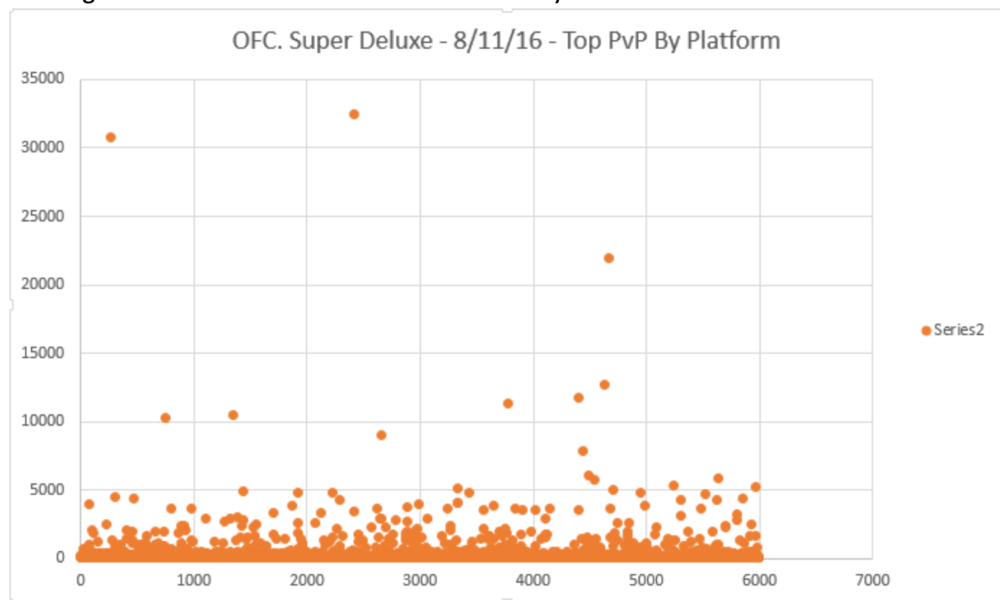

- Because of the outliers at the top of the y-axis (30000 and 20000) the chart looks spanned out bigger and a good trick is to create one more chart but in this chart few outliers at the y-axis (30000, 33000, 22000) will be removed and the rest of the data points below 10000 on the y axis can be left to re-visualize the scatter plot. Now the scatter plot will look maximized and the distribution will make sense.
- Another solution is to take log scale becasue bigger values will apper nearby in logarithmic scale.

# Question 3.b

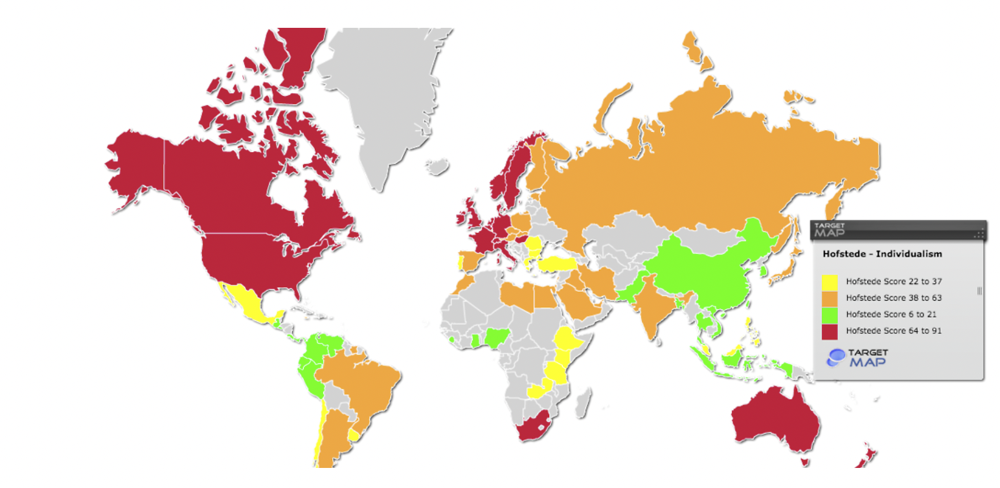

- These plots are plotted based on hofstede - individualism. Between a specific range of hofstede-individualism maps are colored. But still you can see there are few places which looks like grey area are left uncolored. This will create a problem in understanding about the visualization completely because those grey area might be outliers or those might be the scores which are not mentioned on the legends (1 to 5 and 92 to 100).**The grey area should be given a legend to understand more**. And also it is good to represent where the colored places are falling exactly on the ranges in form of discrete values on the map to know about the averages, min and max of a particular hofstede range.
- The chart will look more attractive by making it interactive and tweaking the chart properties.

# Question 3.c

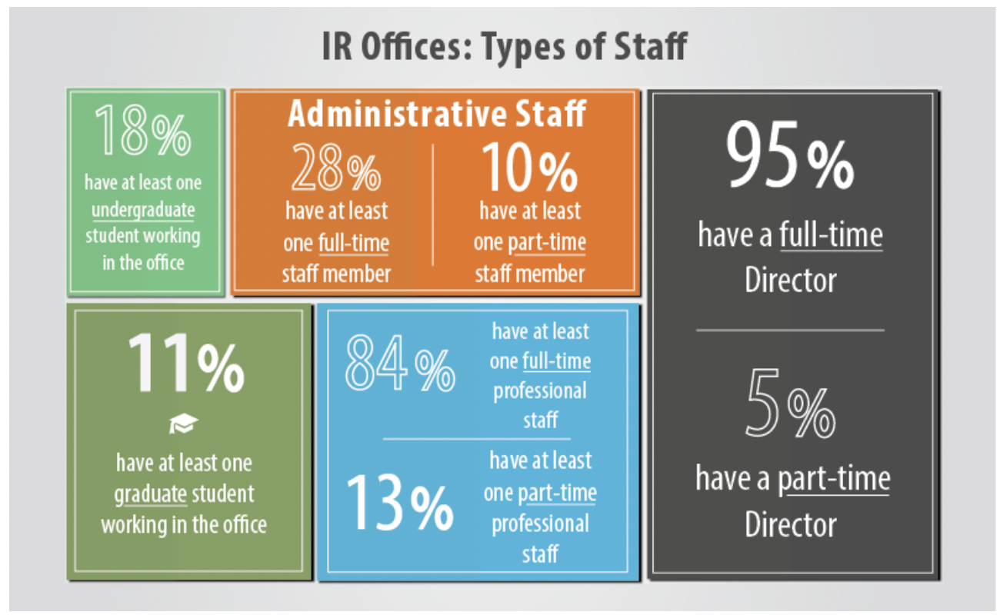

- The chart talks about the IR offices and the types of satff in that office. This chart has four different types of staff director, administrative staff, professional staff and students. The staffs are further subdivided into part-time and full-time. But students alone are divided into undergraduate and graduate. The percentages are really ambiguous as it does not make any sense what percentage exactly is that. There are totally 8 different categories if we are considering the sub categories as seperate category.

- The resolution would be is to distribute the percentages repect to the sub categories(8 categories totally).so the percentage will add up to 100. Now we can plot these sub categories in bar chart as it makes more sense when looking at the highest percent of staff compared to lowest percent of staff.

*or*

- Another resolution is to use group charts. For example administrative staff is talking about 28% of atleast one administrative staff and 10% of atleast one part-time administrative staff in whole office. Likewise every percent talks about the distribution of a group in terms of whole office. It would be great to view all the 8 categories into 4 types. For example (undergraduate, graduate) and (full-time, part-time).